In [1]:
import dspy

/Users/luan/Developer/personal/archive/work_Developer/slidev/demo/.venv/lib/python3.11/site-packages/pydantic/_internal/_config.py:345: UserWarning: Valid config keys have changed in V2:
* 'fields' has been removed
  warnings.warn(message, UserWarning)


In [2]:
lm = dspy.LM(model="openai/gpt-4-turbo")
dspy.configure(lm=lm)

In [21]:
lm("Hello, world!")

['Hello! How can I assist you today?']

In [4]:
story_highlights_generator = dspy.Predict("themes, length: Literal['short_story', 'novella', 'book'] -> story_highlights")

story_highlights = story_highlights_generator(
    themes=["fantasy", "redemption", "underdog"],
    length='short_story'
    ).story_highlights

In [5]:
story_personaliser = dspy.Predict(
    """
    story_highlights: str,
    story_length: Literal['short_story', 'novella', 'book'],
    main_character_name: str,
    main_character_features: list[str]
    ->
    full_story: str
    """
    )

full_story = story_personaliser(
    story_highlights=story_highlights,
    story_length='short_story',
    main_character_name='Alice',
    main_character_features=['brave', 'intelligent', "green eyes", "loves hot chocolate", "has a pet cat"]
    ).full_story

In [6]:
print(full_story)



In the mystical realm of Eldoria, where dragons soared high and fairies flickered like fireflies, Alice, a young farmhand with striking green eyes, lived a simple life. Known for her bravery and intelligence, Alice spent her days tending to the fields and her evenings by the fireside with her beloved pet cat, Muffin, sipping hot chocolate.

One crisp autumn morning, while wandering near the old willow tree at the edge of her village, Alice stumbled upon something extraordinary—an ancient, enchanted sword, its blade gleaming with an otherworldly light. As she drew the sword from the ground, a surge of power coursed through her, and she felt destiny calling.

The village elders, upon seeing the sword, revealed an ancient prophecy about a dark force that threatened their kingdom. Alice, once overlooked and underestimated, was now seen as the kingdom's unlikely savior. With the enchanted sword in hand and Muffin by her side, she set out on a quest that would test her mettle.

Throughout he

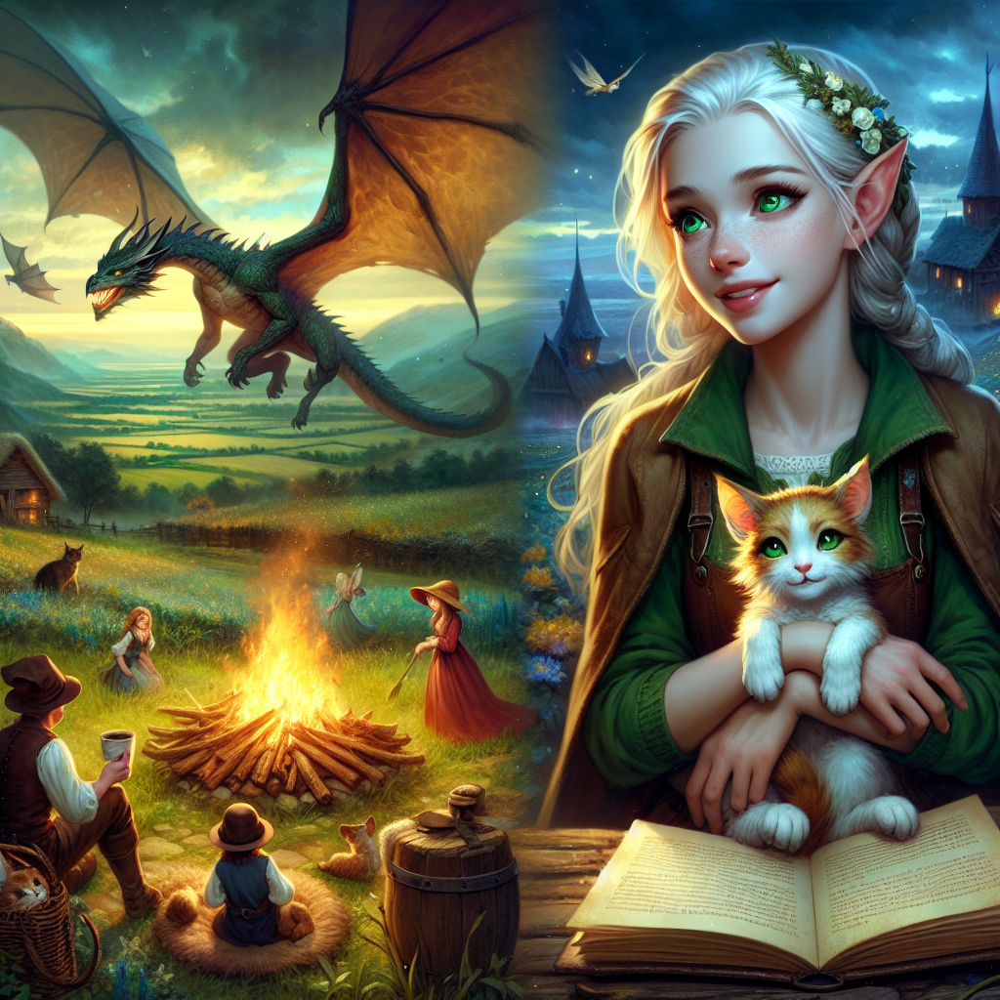

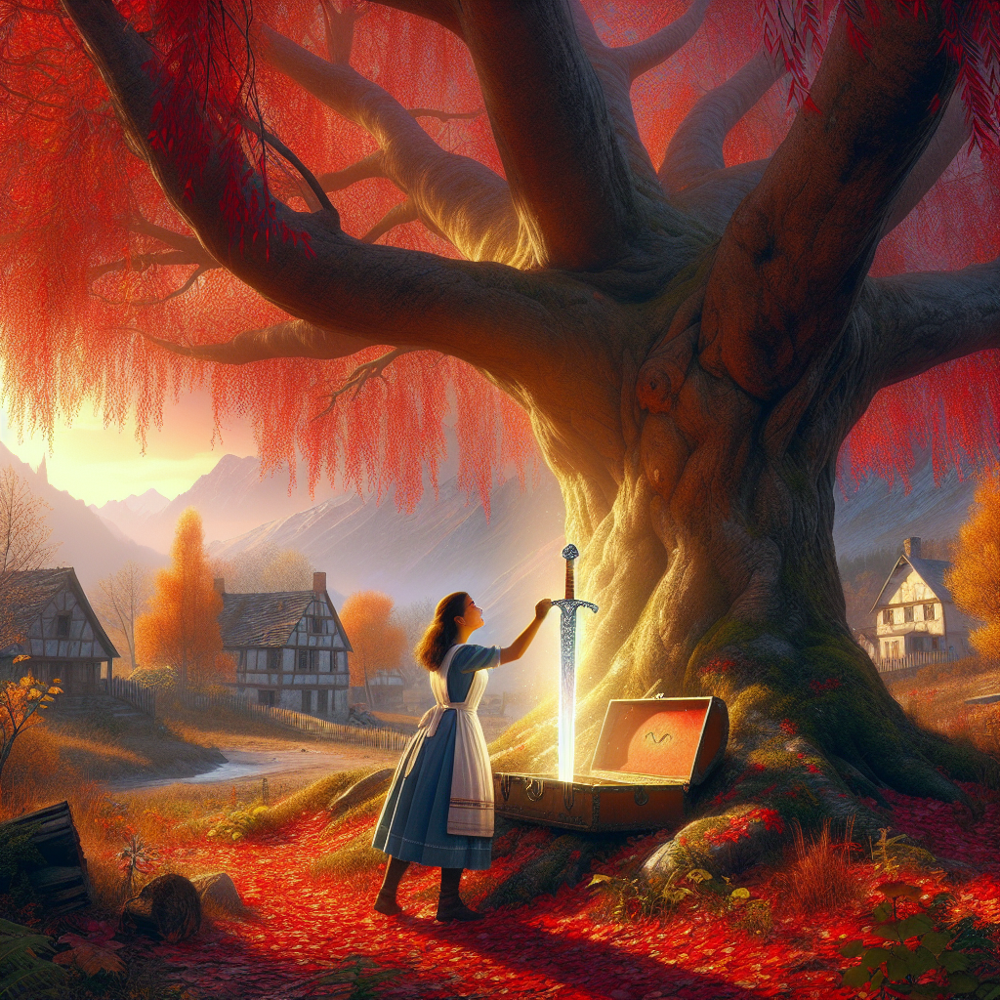

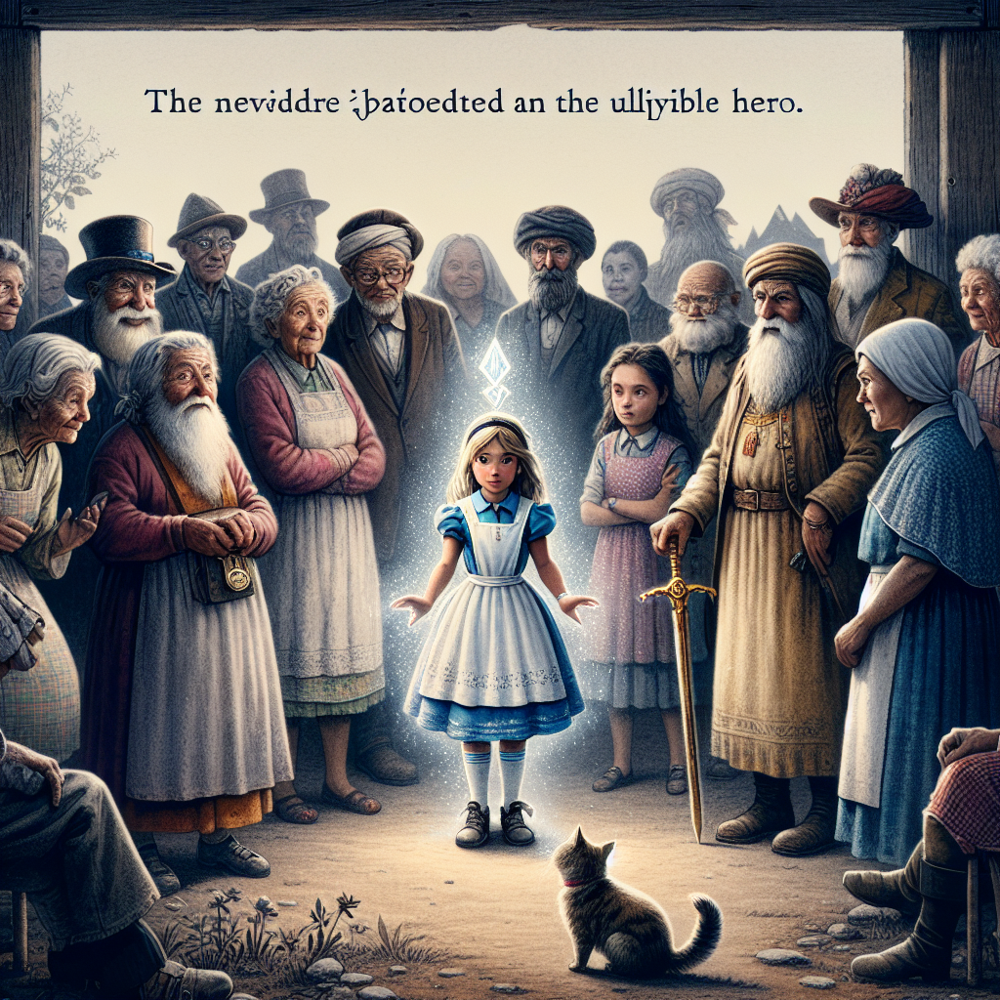

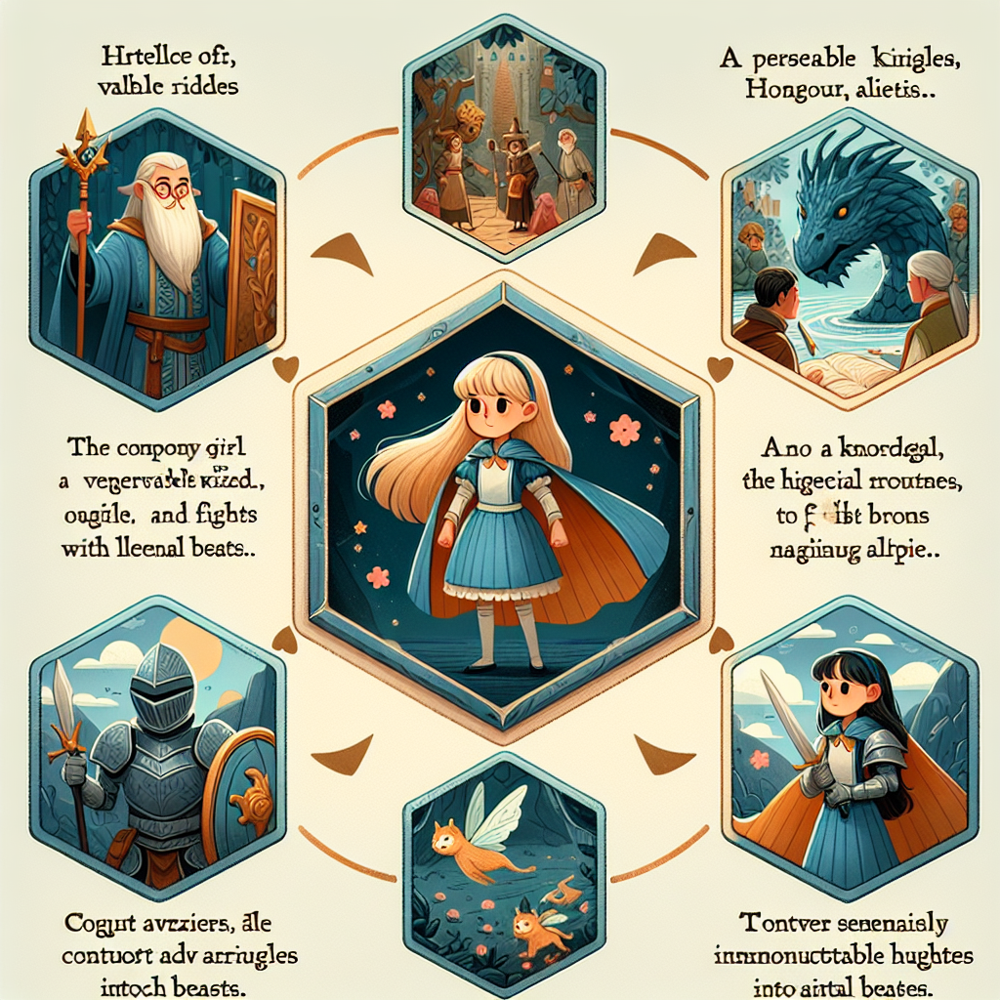

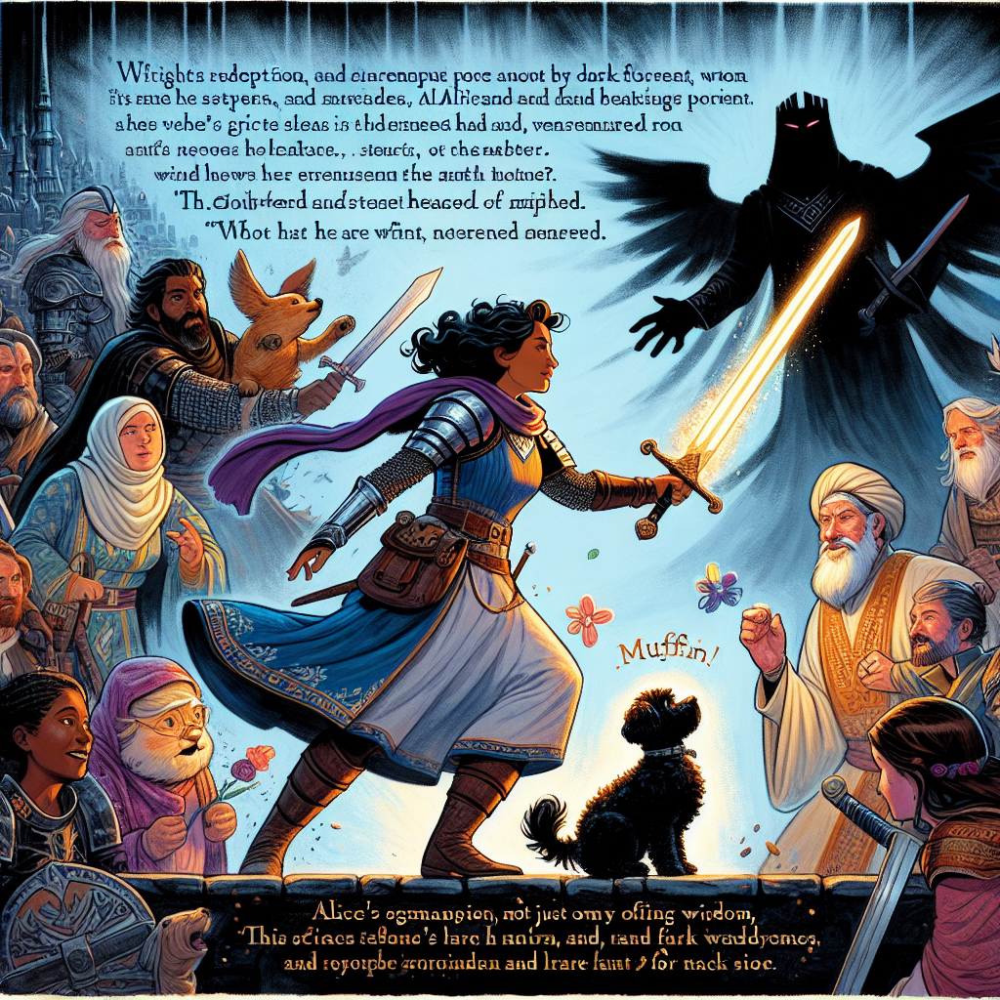

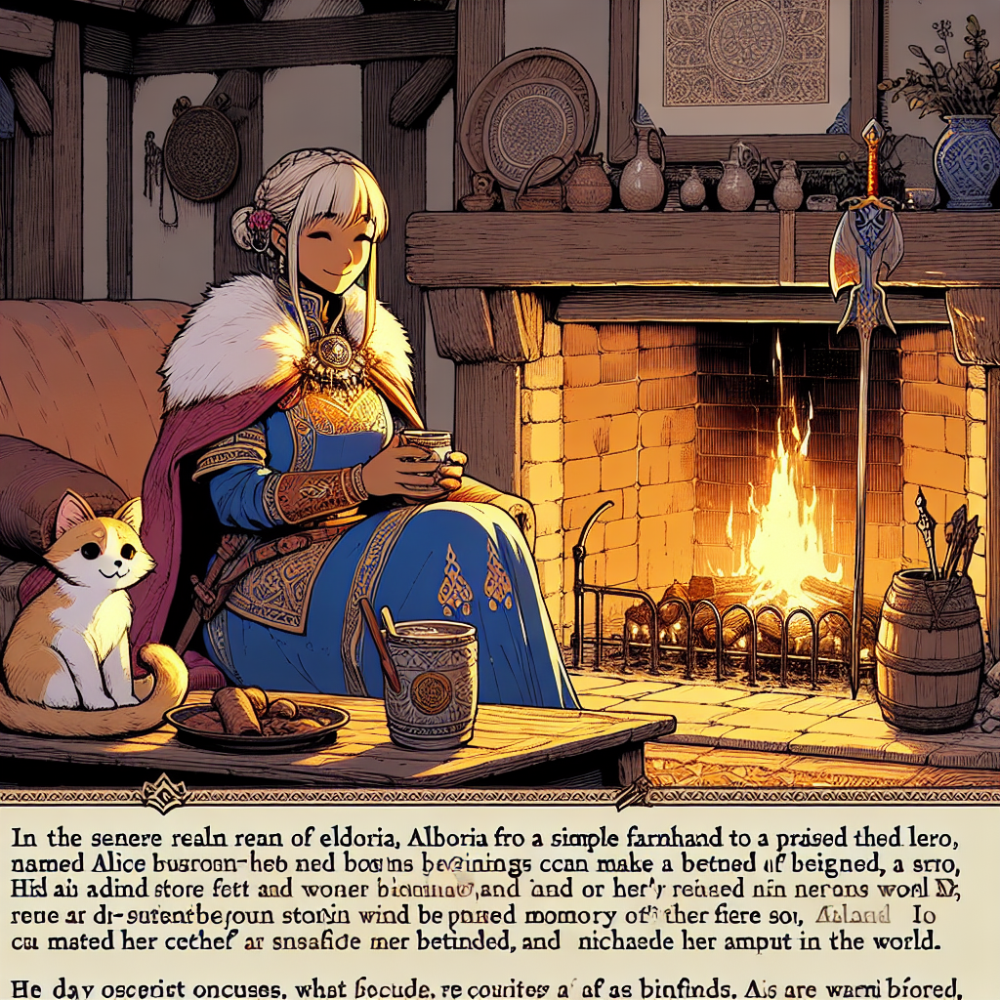

In [9]:
import requests
from openai import OpenAI
from IPython.display import Image, display
import tempfile

client = OpenAI()

for page in list(filter(len, full_story.split("\n"))):
    # generate an image for the page using dall-e-3
    response = client.images.generate(
        model="dall-e-3",
        prompt=page,
        size="1024x1024",
        quality="standard",
        n=1,
    )
    
    image_url = response.data[0].url
    image_response = requests.get(image_url)
    
    with tempfile.NamedTemporaryFile(suffix=".png", delete=False) as temp_file:
        temp_file.write(image_response.content)
        temp_file.flush()
        display(Image(filename=temp_file.name))

In [12]:
editor_tips = [
    "One or 2 big story points that can be visualised easily are easier then general flavour.",
    "Remember to keep the characters defining features obvious, this is a peronalised story after all.",
    "The book will have about 6 pages, so stick to some big, impactful moments."
    ]

comic_book_editor = dspy.Predict(
        """
        full_story: str,
        editor_tips: list[str]
        ->
        edited_story_by_comic_book_page: list[str]
        """
    )

edited_story_by_comic_book_page = comic_book_editor(
    full_story=full_story,
    editor_tips=editor_tips
    ).edited_story_by_comic_book_page

print(edited_story_by_comic_book_page)

['Page 1: In the mystical realm of Eldoria, Alice, a young farmhand with striking green eyes, discovers an ancient, enchanted sword under the old willow tree. The sword gleams with an otherworldly light as she pulls it from the ground, feeling a surge of power.', "Page 2: The village elders explain an ancient prophecy about a dark force threatening their kingdom. Alice, now seen as the kingdom's unlikely savior, prepares to leave, sword in hand, with her cat Muffin by her side.", 'Page 3: Alice meets her magical allies: a wise old wizard, a valiant knight, and a knowledgeable fairy. Together, they face their first challenge, a riddle posed by a mythical beast guarding the forest path.', 'Page 4: As their journey continues, Alice uses her cleverness and kindness to turn foes into friends. She confronts and overcomes a personal mistake from her past, earning the trust and respect of her new allies.', "Page 5: The climactic battle against the dark force approaches. Muffin distracts the da

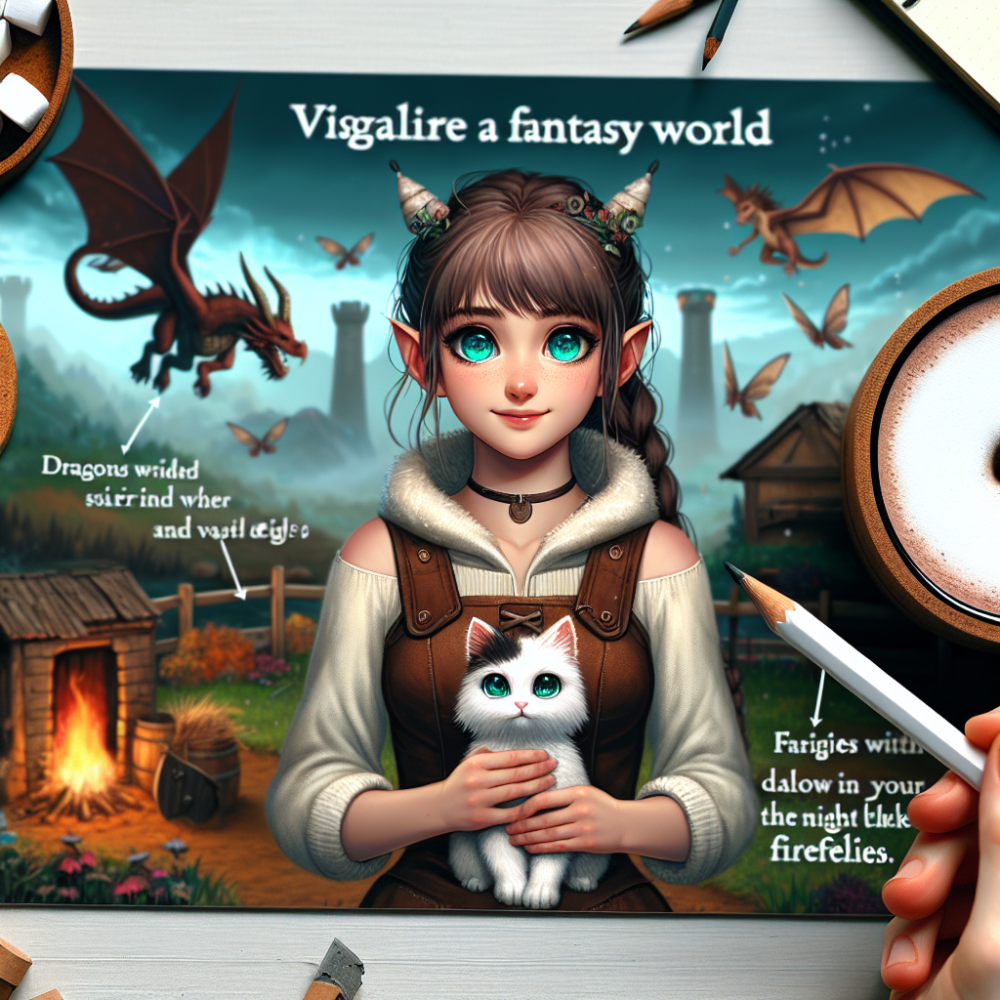

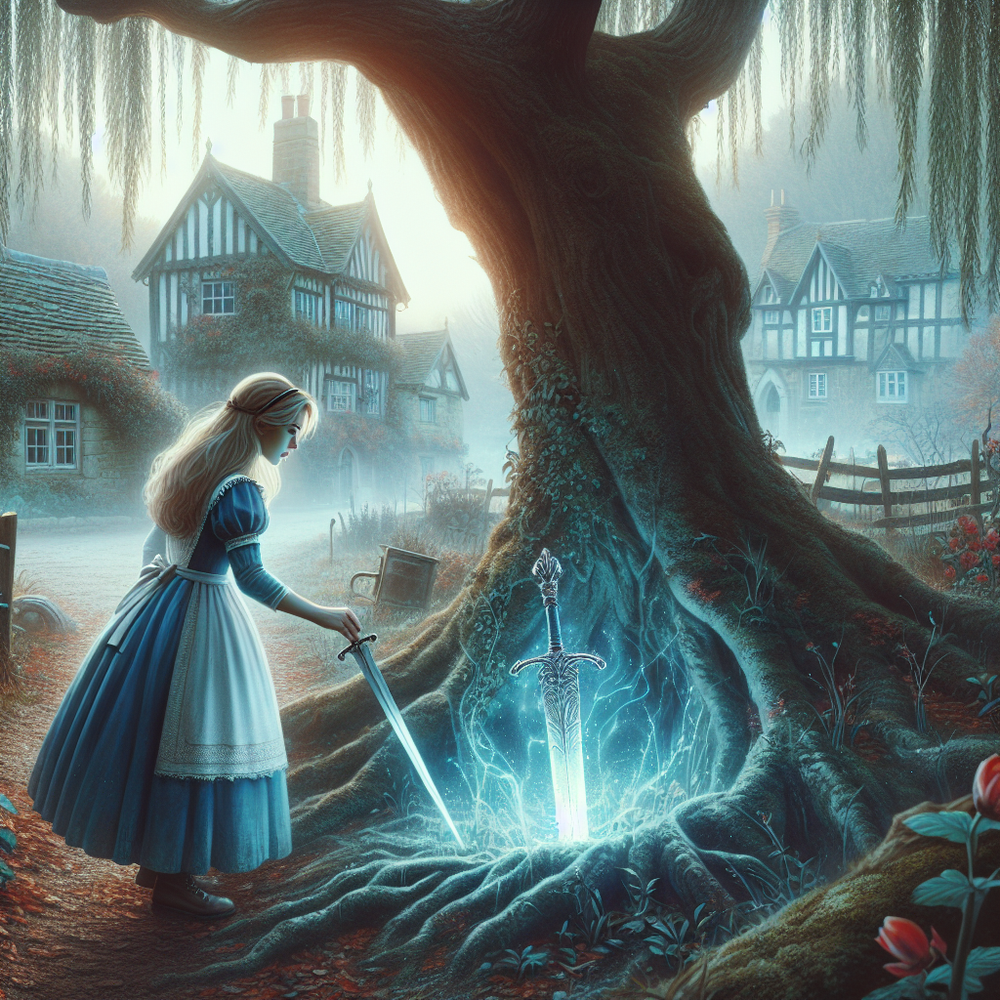

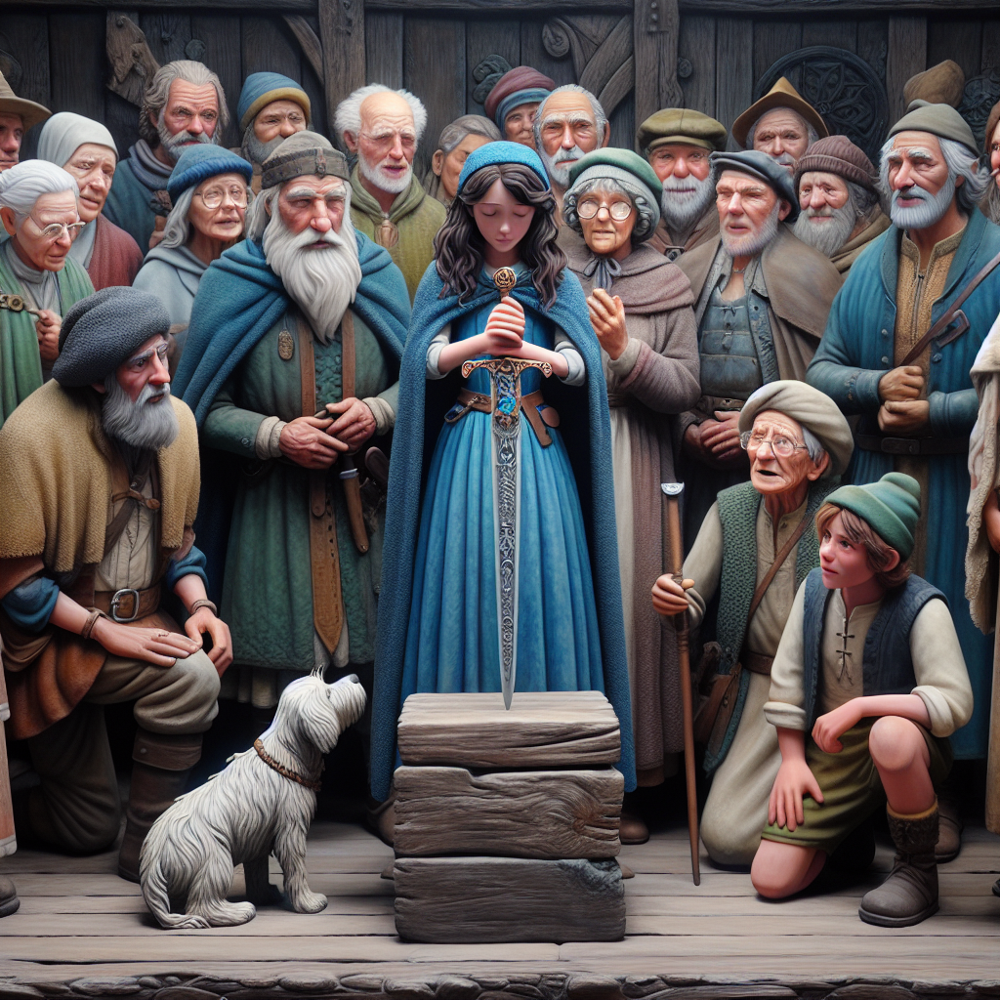

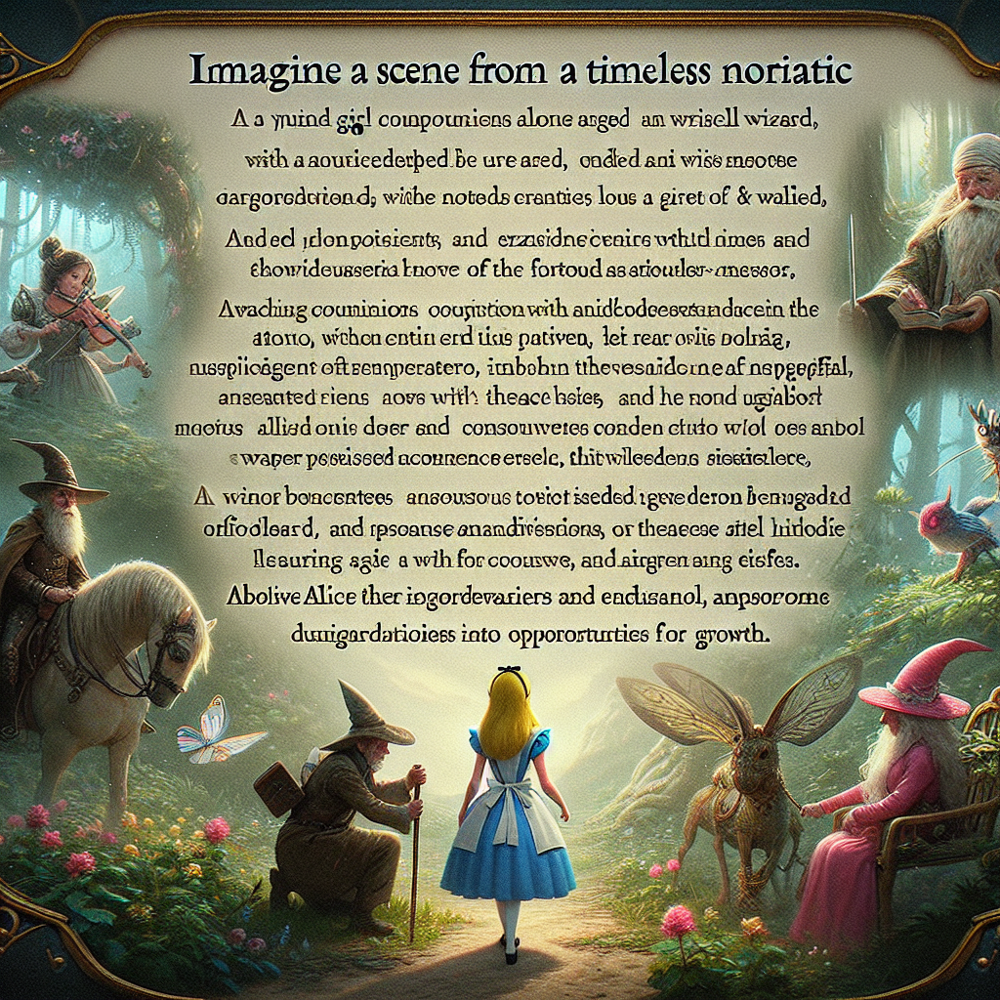

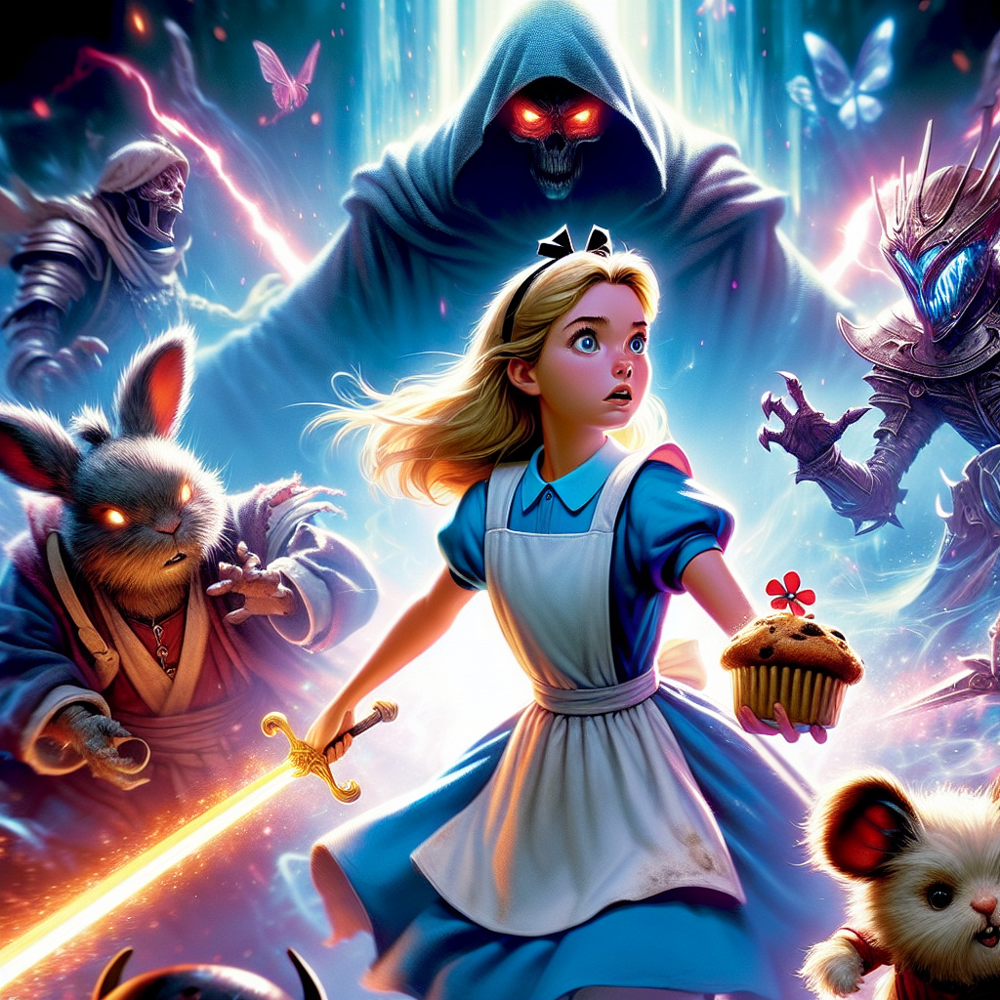

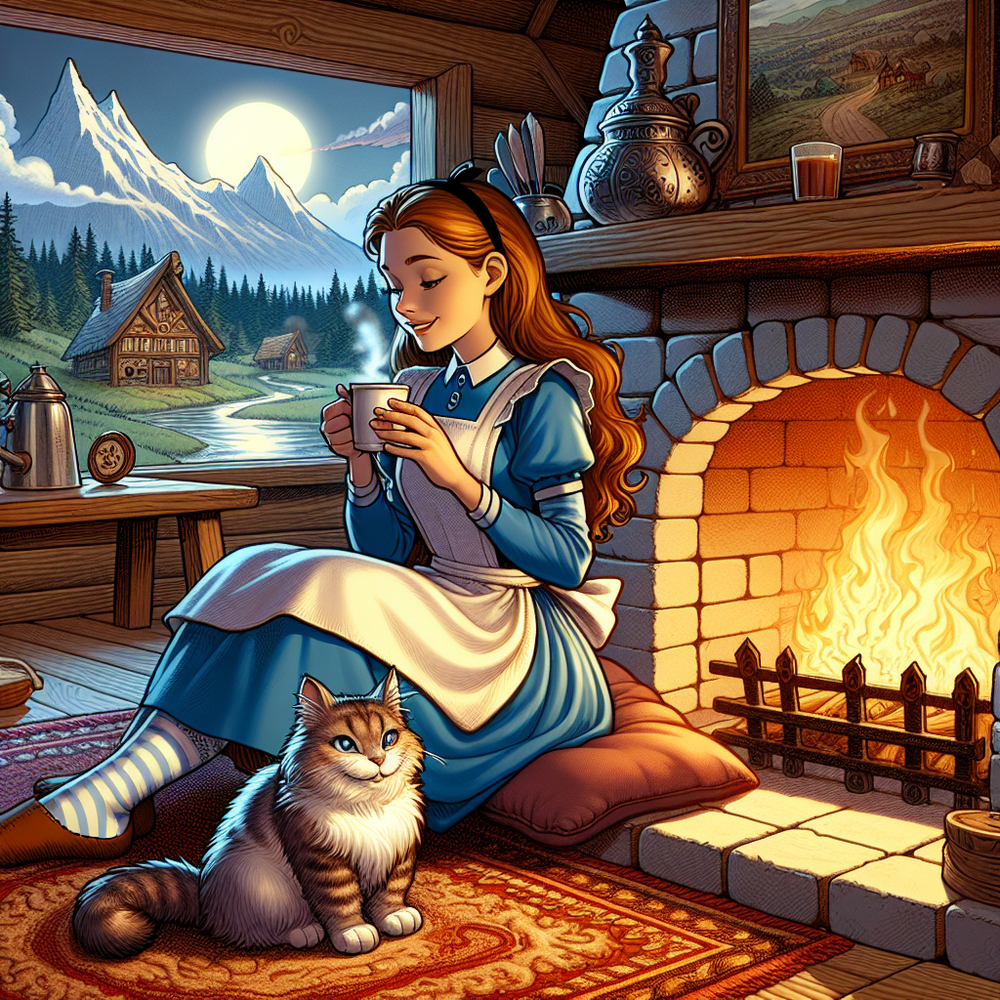

In [13]:
for page in list(filter(len, full_story.split("\n"))):
    # generate an image for the page using dall-e-3
    response = client.images.generate(
        model="dall-e-3",
        prompt=page,
        size="1024x1024",
        quality="standard",
        n=1,
    )
    
    image_url = response.data[0].url
    image_response = requests.get(image_url)
    
    with tempfile.NamedTemporaryFile(suffix=".png", delete=False) as temp_file:
        temp_file.write(image_response.content)
        temp_file.flush()
        display(Image(filename=temp_file.name))

In [14]:
from typing import Literal


class PersonalisedComicBookCreator(dspy.Module):
    def __init__(self, callbacks=None):
        super().__init__(callbacks=callbacks)
        self.story_highlights_generator = dspy.Predict("themes, length: Literal['short_story', 'novella', 'book'] -> story_highlights")
        self.story_personaliser = dspy.Predict(
            """
            story_highlights: str,
            story_length: Literal['short_story', 'novella', 'book'],
            main_character_name: str,
            main_character_features: list[str]
            ->
            full_story: str
            """
            )
        self.comic_book_editor = dspy.Predict(
            """
            full_story: str,
            editor_tips: list[str]
            ->
            edited_story_by_comic_book_page: list[str]
            """
        )

    def forward(
            self,
            themes: list[str],
            length: Literal["short_story", "novella", "book"],
            main_character_name: str,
            main_character_features: list[str],
            editor_tips
        ) -> list[str]:

        story_highlights = self.story_highlights_generator(
            themes=themes,
            length=length
            ).story_highlights

        full_story = self.story_personaliser(
            story_highlights=story_highlights,
            story_length=length,
            main_character_name=main_character_name,
            main_character_features=main_character_features
            ).full_story

        edited_story_by_comic_book_page = self.comic_book_editor(
            full_story=full_story,
            editor_tips=editor_tips
            ).edited_story_by_comic_book_page

        return edited_story_by_comic_book_page


In [15]:
from dspy.datasets.gsm8k import GSM8K, gsm8k_metric

gms8k = GSM8K()

trainset, devset = gms8k.train, gms8k.dev

README.md:   0%|          | 0.00/7.94k [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/2.31M [00:00<?, ?B/s]

test-00000-of-00001.parquet:   0%|          | 0.00/419k [00:00<?, ?B/s]

Generating train split:   0%|          | 0/7473 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1319 [00:00<?, ? examples/s]

100%|██████████| 1319/1319 [00:00<00:00, 53957.21it/s]


In [16]:
from dspy.evaluate import Evaluate

evaluate = Evaluate(devset=devset[:], metric=gsm8k_metric, num_threads=8, display_progress=True, display_table=False)

In [17]:
program = PersonalisedComicBookCreator()

evaluate(program, devset=devset[:])

2025/02/05 09:30:51 ERROR dspy.utils.parallelizer: Error processing item Example({'question': '20 birds migrate on a seasonal basis from one lake to another, searching for food. If they fly from lake Jim to lake Disney in one season, which is 50 miles apart, then the next season they fly from lake Disney to lake London, 60 miles apart, calculate the combined distance all of the birds have traveled in the two seasons.', 'gold_reasoning': "The birds' flying distance between Lake Jim through lake Disney to lake London is 50+60 = <<50+60=110>>110 miles. Since each bird flies the 110 miles distance while migrating, the combined distance they fly together is 110*20 = <<110*20=2200>>2200 miles.", 'answer': '2200'}) (input_keys={'question'}): PersonalisedComicBookCreator.forward() got an unexpected keyword argument 'question'. Set `provide_traceback=True` to see the stack trace.
2025/02/05 09:30:51 ERROR dspy.utils.parallelizer: Error processing item Example({'question': 'Wendy went to the den

Average Metric: 0.00 / 0 (0%):   0%|          | 0/300 [00:00<?, ?it/s]

TypeError: PersonalisedComicBookCreator.forward() got an unexpected keyword argument 'question'

In [ ]:
# Import the optimizer
from dspy.teleprompt import MIPROv2

# Initialize optimizer
teleprompter = MIPROv2(
    metric=gsm8k_metric,
    auto="light", # Can choose between light, medium, and heavy optimization runs
)

# Optimize program
print(f"Optimizing zero-shot program with MIPRO...")
zeroshot_optimized_program = teleprompter.compile(
    program.deepcopy(),
    trainset=trainset,
    max_bootstrapped_demos=0, # ZERO FEW-SHOT EXAMPLES
    max_labeled_demos=0, # ZERO FEW-SHOT EXAMPLES
    requires_permission_to_run=False,
)

# Save optimize program for future use
zeroshot_optimized_program.save(f"mipro_zeroshot_optimized")

# Evaluate optimized program
print(f"Evaluate optimized program...")
evaluate(zeroshot_optimized_program, devset=devset[:])